<a href="https://colab.research.google.com/github/benedettacandelori/Monkeys_go_stop_trials/blob/main/transformers_2D.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Import libraries



In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
import scipy.io
import os
import math
import torch

In [3]:
os.chdir('/content/drive/MyDrive')
os.getcwd() 

'/content/drive/MyDrive'

In [4]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(device)

cuda


In [5]:
%pip install pytorch_lightning einops seaborn --quiet
!pip install positional-encodings[pytorch,tensorflow]

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 719.0/719.0 kB 15.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.2/42.2 kB 4.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 519.2/519.2 kB 36.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 71.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 114.5/114.5 kB 14.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 268.8/268.8 kB 29.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 149.6/149.6 kB 19.5 MB/s eta 0:00:00
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [6]:
import math
import torch
import seaborn as sns
import matplotlib.pyplot as plt
from torch import nn
import pandas as pd
import numpy as np
from torch.utils.data import Dataset, DataLoader
import torch.nn.functional as F
import pytorch_lightning as pylight
from einops.layers.torch import Rearrange
from einops import reduce, rearrange, repeat
from positional_encodings.torch_encodings import PositionalEncoding1D, PositionalEncoding2D, PositionalEncoding3D, Summer
from torchmetrics.classification import Accuracy, F1Score, MulticlassAccuracy,BinaryAccuracy

# Dataset

### Dataset creation

In [7]:
class Monkeys_dataset(Dataset):
    """Monkeys dataset"""

    def __init__(self, mat_file_labels, mat_file_x, root_dir, start_idx = 800, end_idx = 1200):
        """
        Args:
            mat_file (string): Path to the .mat files.
            root_dir (string): Directory with all the data.
        """
        self.classes = scipy.io.loadmat(mat_file_labels)['nostop']
        self.data = scipy.io.loadmat(mat_file_x)['matrix']
        self.root_dir = root_dir
        self.start_idx = start_idx
        self.end_idx = end_idx

    def __len__(self):
        return len(self.classes)

    def __getitem__(self, idx):
        if torch.is_tensor(idx):
            idx = idx.tolist()


        x = self.data[:,idx,self.start_idx:self.end_idx]
        x = torch.tensor(x).float().squeeze(0)#.unsqueeze(1) 
        label = int(self.classes[idx,1])
      
        #sample = {'matrix': x, 'class': label}
        sample = (x, label)

        return sample

In [8]:
start= 350
end = 750

In [9]:
dataset = Monkeys_dataset(mat_file_labels = 'Stop_Task_Collab_2023/BHV_Go.mat', mat_file_x = 'Stop_Task_Collab_2023/activity_movement_onset_Go.mat',
                                    root_dir='Stop_Task_Collab_2023/', start_idx = start, end_idx = end)


In [10]:
print(dataset[0][0].shape)
print(dataset[0][1])

torch.Size([105, 400])
2


### Data loader

In [11]:
# We split the dataset in training and test portions
monkey_train, monkey_val, monkey_test = torch.utils.data.random_split(dataset, [0.7, 0.2, 0.1])

In [12]:
batch_size = 8

In [13]:
# Loaders create mini-batches of images from the original dataset
loader_train = torch.utils.data.DataLoader(monkey_train, batch_size=batch_size, shuffle=True,)
loader_val = torch.utils.data.DataLoader(monkey_val, batch_size=batch_size, shuffle=False)
loader_test = torch.utils.data.DataLoader(monkey_test, batch_size=batch_size, shuffle=False)

In [14]:
for xb, yb in loader_train:
  break
print(xb.shape)
print(yb.shape)

torch.Size([8, 105, 400])
torch.Size([8])


# Transformer





In [12]:
class SelfMHA(nn.Module):
  def __init__(self, d_input, d_value, d_query, d_output, n_heads=8, dropout=0.0):
      super().__init__()
      self.n_heads = n_heads
      self.query = nn.Linear(d_input, d_query * n_heads)
      self.keys = nn.Linear(d_input, d_query * n_heads)
      self.values = nn.Linear(d_input, d_value * n_heads)
      self.output = nn.Linear(d_value * n_heads, d_output)
      self.drop = nn.Dropout(dropout)

  def forward(self, x):
      Q = rearrange(self.query(x), 'b seq (q heads) -> b heads seq q', heads = self.n_heads)
      #print('Q-->',Q.shape)
      K = rearrange(self.keys(x), 'b seq (q heads) -> b heads seq q', heads = self.n_heads)
      #print('K-->',K.shape)
      V = rearrange(self.values(x), 'b seq (v heads) -> b heads seq v', heads = self.n_heads)
      #print('V-->',V.shape)
      A = torch.einsum('b h s q, b h t q -> b h s t', [Q, K]) / math.sqrt(Q.shape[-1])
      A = torch.softmax(A, dim=3)
      #print('A-->',A.shape)

      O = torch.einsum('b h s t, b h t v -> b h s v', [A, V])
      O = rearrange(O, 'b heads seq v -> b seq (heads v)')
      return self.drop(self.output(O)), A

In [13]:
class TransformerBlock(nn.Module):
  def __init__(self, d_input, d_hidden, num_heads = 5):
    super().__init__()
    #self.sa = nn.MultiheadAttention(embed_dim=d_input, num_heads=num_heads, batch_first=True)
    self.sa = SelfMHA(d_input, d_hidden, d_hidden, d_input, n_heads=6, dropout=0.)
    self.ln1 = nn.LayerNorm(d_input)
    self.ln2 = nn.LayerNorm(d_input)
    self.dense = nn.Sequential(
        nn.Linear(d_input, d_hidden),
        nn.GELU(),
        nn.Linear(d_hidden, d_input)
    )

  def forward(self, x):
    x = self.ln1(x)
    x_t, a = self.sa(x)
    x = x_t + x
    x = self.dense(self.ln2(x)) + x
    return x, a

In [14]:
from torch.functional import align_tensors
class Transformer(pylight.LightningModule):

  def __init__(self, d_space = 105,  d_time = 400,  n_classes=2, hidden_dimension=128, dropout = 0.1, learning_rate = 0.00001):
    super().__init__()
    #self.input_embedding = Embedding(hidden_dimension)
    
    self.space = TransformerBlock(d_space, d_space)
    self.time = TransformerBlock(d_time, d_time)
    self.classifier = nn.Linear(d_space, n_classes)
    self.acc = MulticlassAccuracy(num_classes=n_classes)
    self.learning_rate = learning_rate
    self.dropout = nn.Dropout(dropout)

  def forward(self, x):    
    x, a_s = self.time(x)
    x = rearrange(x, 'b s t -> b t s')
    x, a_t = self.space(x)
    x = self.dropout(x)
    x = reduce(x, 'b time out -> b out', reduction='max')
    return self.classifier(x), a_s, a_t

  @torch.no_grad()
  def get_attention_map(self, x):
      """Function for extracting the attention matrices of the whole Transformer for a single batch.
      Input arguments same as the forward pass.
      """
      
      _, a_s, a_t = self(x)
      
      return a_s, a_t

  def configure_optimizers(self):
    return torch.optim.Adam(self.parameters(), lr = self.learning_rate) 

  def training_step(self, batch, batch_idx):
    xb, yb = batch
    yb = yb - 1 # Matlab starts from 1

    y_pred, a_s, a_t = self(xb)
    loss = F.cross_entropy(y_pred, yb.long())
    acc = self.acc(y_pred, yb)
    
    self.log("train_loss", loss, on_step=False, on_epoch=True, prog_bar=True)
    self.log("train_acc", acc, on_step=False, on_epoch=True, prog_bar=True)
    return loss

  def validation_step(self, batch, batch_idx):
    xb, yb = batch
    yb = yb - 1

    y_pred, a_s, a_t = self(xb)
    
    acc = self.acc(y_pred, yb)
    loss = F.cross_entropy(y_pred, yb.long())

    self.log("val_loss", loss, on_step=False, on_epoch=True, prog_bar=True)
    self.log("val_acc", acc, on_step=False, on_epoch=True, prog_bar=True)
    return loss

  def test_step(self, batch, batch_idx):
    xb, yb = batch
    yb = yb - 1
    y_pred, a_s, a_t = self(xb)
    self.acc(y_pred, yb)
    self.log("test_acc", self.acc, on_step=False, on_epoch=True, prog_bar=True)
    return self.acc

In [ ]:
#sanity check
out, a_s, a_t= Transformer()(xb)
print(out.shape)
print(a_s.shape)
print(a_t.shape)

In [ ]:
model = Transformer(dropout = 0.3, learning_rate = 0.00002)
trainer = pylight.Trainer(max_epochs=30, accelerator='gpu', devices=1,default_root_dir="/content/drive/MyDrive/")
trainer.fit(model, loader_train, loader_val)


In [149]:
trainer.test(model, dataloaders=loader_test)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: 0it [00:00, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_acc          │           0.625           │
└───────────────────────────┴───────────────────────────┘

[{'test_acc': 0.625}]

In [135]:
x = next(iter(loader_test))[0]
a_s, a_t = model.get_attention_map(x)

In [136]:
a_s = reduce(a_s, 'n head s1 s2 -> head s1 s2', reduction='mean').detach()
a_t = reduce(a_t, 's head n1 n2 -> head n1 n2', reduction='mean').detach()
print("space attention",a_s.shape)
print("time attention", a_t.shape)

space attention torch.Size([6, 105, 105])
time attention torch.Size([6, 400, 400])


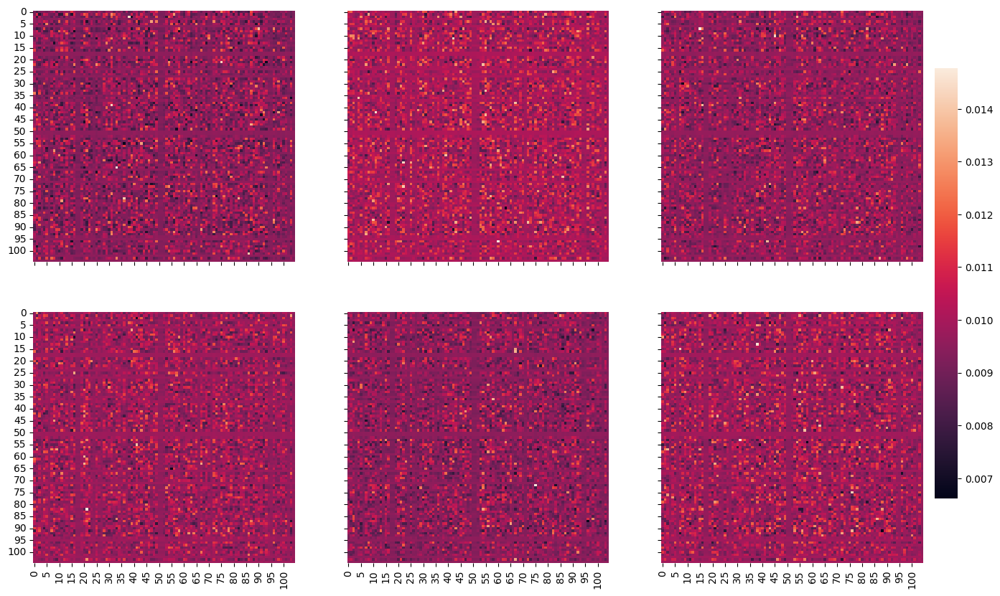

In [137]:
fig, axn = plt.subplots(2, 3, figsize=(16, 10), sharex=True, sharey=True)
cbar_ax = fig.add_axes([.91, .2, .02, .6])

for i, ax in enumerate(axn.flat):
    sns.heatmap(a_s[i-1].numpy(), ax=ax,
                cbar=i == 0,
                cbar_ax=None if i else cbar_ax)

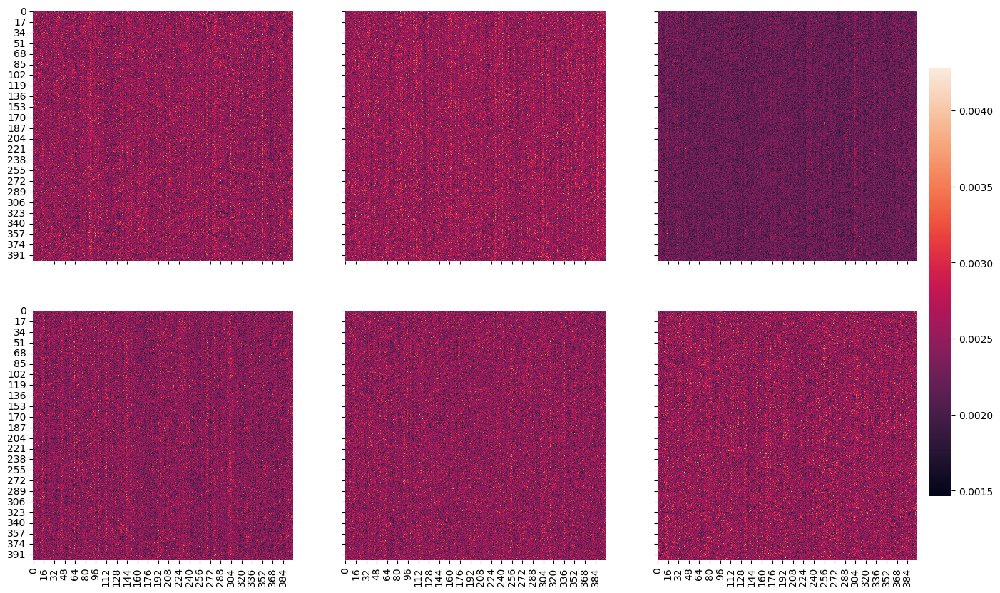

In [138]:
fig, axn = plt.subplots(2, 3, figsize=(16, 10), sharex=True, sharey=True)
cbar_ax = fig.add_axes([.91, .2, .02, .6])

for i, ax in enumerate(axn.flat):
    sns.heatmap(a_t[i-1].numpy(), ax=ax,
                cbar=i == 0,
                cbar_ax=None if i else cbar_ax)

### Training and experiments

In [14]:
bs = 8
n_epochs = 30
lr = 0.00002 # 0.001
dropout = 0.3

In [ ]:
configuration = "b="+str(bs)+",ep="+str(n_epochs)+",lr="+str(lr)
lag = np.arange(0,500,100)
start = 500
end = 900
for idx, lag in enumerate(lag):
  range_ms = str(1000-(start-lag))+'-'+str(1000-(end-lag))
  print()
  print('Start training... for the range of ms before the moviment: ', range_ms)
  print()

  dataset = Monkeys_dataset(mat_file_labels = 'Stop_Task_Collab_2023/BHV_Go.mat', mat_file_x = 'Stop_Task_Collab_2023/activity_movement_onset_Go.mat',
                                    root_dir='Stop_Task_Collab_2023/', start_idx = start-lag, end_idx = end-lag)
  
  monkey_train, monkey_val, monkey_test = torch.utils.data.random_split(dataset, [0.7, 0.2, 0.1])
  # Loaders create mini-batches of images from the original dataset
  loader_train = torch.utils.data.DataLoader(monkey_train, batch_size=bs, shuffle=True,)
  loader_val = torch.utils.data.DataLoader(monkey_val, batch_size=bs, shuffle=False)
  loader_test = torch.utils.data.DataLoader(monkey_test, batch_size=bs, shuffle=False)
  
  logger = pylight.loggers.TensorBoardLogger(save_dir='.', version=configuration+'-'+range_ms, name='Transformer1_2D_logs')
  model = Transformer(learning_rate = lr, dropout = dropout)
  trainer = pylight.Trainer(max_epochs=n_epochs, accelerator='gpu', devices=1,default_root_dir="/content/drive/MyDrive/", logger=logger)
  trainer.fit(model, loader_train, loader_val)

In [16]:
%reload_ext tensorboard
%tensorboard --logdir=Transformer1_2D_logs/
# !kill 3542

<IPython.core.display.Javascript object>

## other experiments

In [8]:
# nascondo 300 ms prima del movimento
start= 100
end = 700

In [9]:
dataset = Monkeys_dataset(mat_file_labels = 'Stop_Task_Collab_2023/BHV_Go.mat', mat_file_x = 'Stop_Task_Collab_2023/activity_movement_onset_Go.mat',
                                    root_dir='Stop_Task_Collab_2023/', start_idx = start, end_idx = end)


In [11]:
# We split the dataset in training and test portions
monkey_train, monkey_val, monkey_test = torch.utils.data.random_split(dataset, [0.7, 0.2, 0.1])
# Loaders create mini-batches of images from the original dataset
batch_size = 8
loader_train = torch.utils.data.DataLoader(monkey_train, batch_size=batch_size, shuffle=True,)
loader_val = torch.utils.data.DataLoader(monkey_val, batch_size=batch_size, shuffle=False)
loader_test = torch.utils.data.DataLoader(monkey_test, batch_size=batch_size, shuffle=False)

In [16]:
model = Transformer(d_time = 600, dropout = 0.2, learning_rate = 0.00001)
trainer = pylight.Trainer(max_epochs=30, accelerator='gpu', devices=1,default_root_dir="/content/drive/MyDrive/")
trainer.fit(model, loader_train, loader_val)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name       | Type               | Params
--------------------------------------------------
0 | space      | TransformerBlock   | 289 K 
1 | time       | TransformerBlock   | 9.4 M 
2 | classifier | Linear             | 212   
3 | acc        | MulticlassAccuracy | 0     
4 | dropout    | Dropout            | 0     
--------------------------------------------------
9.7 M     Trainable params
0         Non-trainable params
9.7 M     Total params
38.658    Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=30` reached.


In [17]:
trainer.test(model, dataloaders=loader_test)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: 0it [00:00, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_acc          │    0.7288388013839722     │
└───────────────────────────┴───────────────────────────┘

[{'test_acc': 0.7288388013839722}]

In [18]:
x = next(iter(loader_test))[0]
a_s, a_t = model.get_attention_map(x)

In [19]:
a_s = reduce(a_s, 'n head s1 s2 -> head s1 s2', reduction='mean').detach()
a_t = reduce(a_t, 's head n1 n2 -> head n1 n2', reduction='mean').detach()
print("space attention",a_s.shape)
print("time attention", a_t.shape)

space attention torch.Size([6, 105, 105])
time attention torch.Size([6, 600, 600])


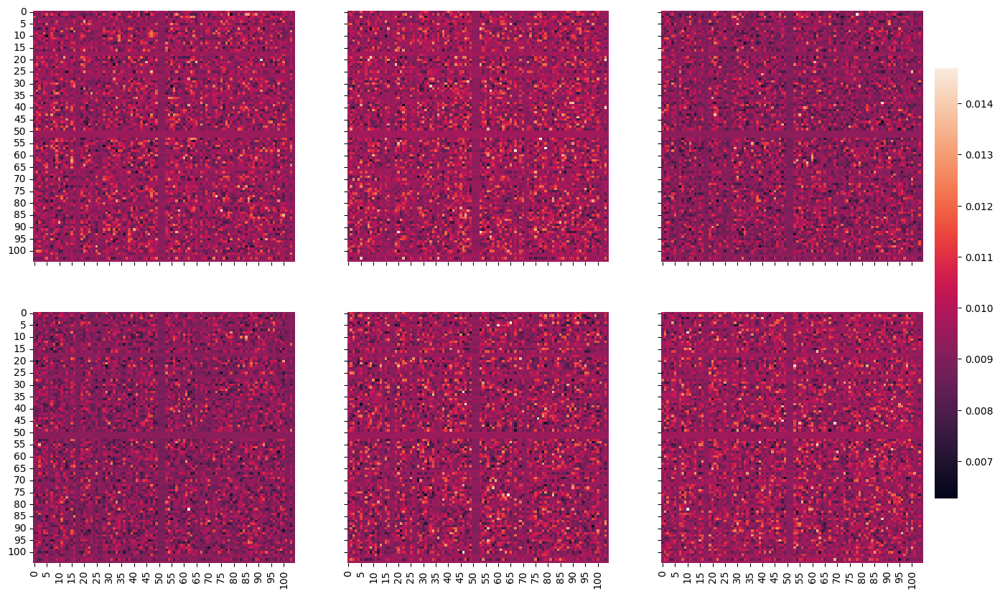

In [20]:
fig, axn = plt.subplots(2, 3, figsize=(16, 10), sharex=True, sharey=True)
cbar_ax = fig.add_axes([.91, .2, .02, .6])

for i, ax in enumerate(axn.flat):
    sns.heatmap(a_s[i-1].numpy(), ax=ax,
                cbar=i == 0,
                cbar_ax=None if i else cbar_ax)

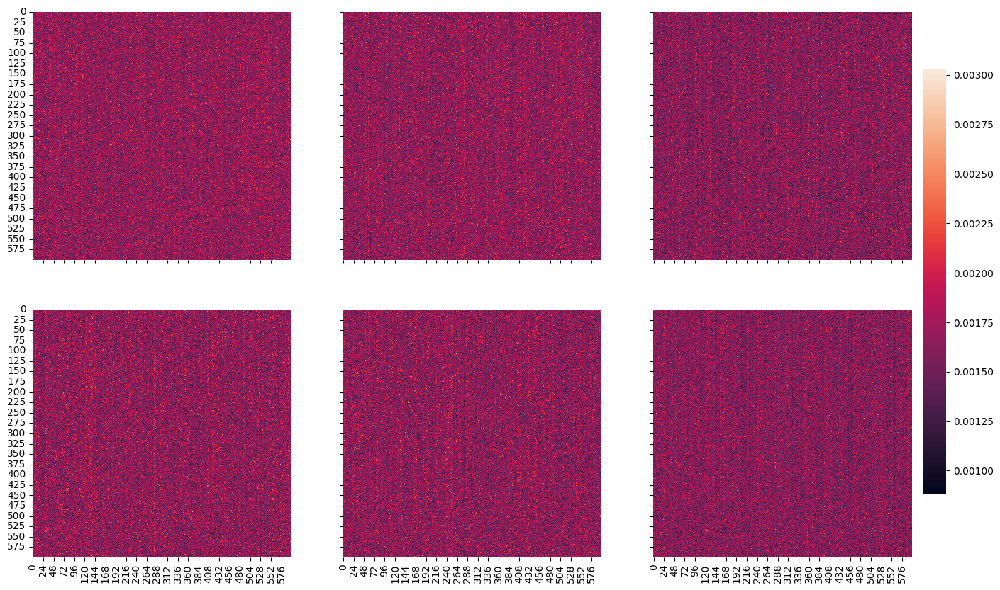

In [21]:
fig, axn = plt.subplots(2, 3, figsize=(16, 10), sharex=True, sharey=True)
cbar_ax = fig.add_axes([.91, .2, .02, .6])

for i, ax in enumerate(axn.flat):
    sns.heatmap(a_t[i-1].numpy(), ax=ax,
                cbar=i == 0,
                cbar_ax=None if i else cbar_ax)

# Transformer with multiple encoder layers

In [15]:
class SelfMHA(nn.Module):
  def __init__(self, d_input, d_value, d_query, d_output, n_heads=8, dropout=0.0):
      super().__init__()
      self.n_heads = n_heads
      self.query = nn.Linear(d_input, d_query * n_heads)
      self.keys = nn.Linear(d_input, d_query * n_heads)
      self.values = nn.Linear(d_input, d_value * n_heads)
      self.output = nn.Linear(d_value * n_heads, d_output)
      self.drop = nn.Dropout(dropout)

  def forward(self, x):
      Q = rearrange(self.query(x), 'b seq (q heads) -> b heads seq q', heads = self.n_heads)
      #print('Q-->',Q.shape)
      K = rearrange(self.keys(x), 'b seq (q heads) -> b heads seq q', heads = self.n_heads)
      #print('K-->',K.shape)
      V = rearrange(self.values(x), 'b seq (v heads) -> b heads seq v', heads = self.n_heads)
      #print('V-->',V.shape)
      A = torch.einsum('b h s q, b h t q -> b h s t', [Q, K]) / math.sqrt(Q.shape[-1])
      A = torch.softmax(A, dim=3)
      #print('A-->',A.shape)

      O = torch.einsum('b h s t, b h t v -> b h s v', [A, V])
      O = rearrange(O, 'b heads seq v -> b seq (heads v)')
      return self.drop(self.output(O)), A

In [71]:
class TransformerBlock(nn.Module):
  def __init__(self, d_input, d_hidden, num_heads = 5):
    super().__init__()
    #self.sa = nn.MultiheadAttention(embed_dim=d_input, num_heads=num_heads, batch_first=True)
    self.sa = SelfMHA(d_input, d_hidden, d_hidden, d_input, n_heads=num_heads, dropout=0.)
    self.ln1 = nn.LayerNorm(d_input)
    self.ln2 = nn.LayerNorm(d_input)
    self.dense = nn.Sequential(
        nn.Linear(d_input, d_hidden),
        nn.GELU(),
        nn.Linear(d_hidden, d_input)
    )

  def forward(self, x):
    x = self.ln1(x)
    x_t, a = self.sa(x)
    x = x_t + x
    x = self.dense(self.ln2(x)) + x
    return x, a

In [72]:
class TransformerEncoder(nn.Module):

  def __init__(self,d_input, d_hidden,num_heads=5, num_layers = 3, **block_args):
    super().__init__()
    self.layers = nn.ModuleList([TransformerBlock(d_input, d_hidden,num_heads) for _ in range(num_layers)])

  def forward(self, x):
    for l in self.layers:
      x, att = l(x)
    return x, att

  def get_attention_maps(self, x):
    attention_maps = []
    for l in self.layers:
        _, attn_map = l.sa(x)
        #attn_map = reduce(attn_map, 'b time out -> time out', reduction='mean')
        attention_maps.append(attn_map)
        x, att = l(x)
    return attention_maps

In [73]:
from torch.functional import align_tensors
class Transformer(pylight.LightningModule):

  def __init__(self, d_space = 105,  d_time = 400, num_heads = 5, num_layers = 3, n_classes=2, hidden_dimension=128, dropout = 0.1, learning_rate = 0.00001):
    super().__init__()
    #self.input_embedding = Embedding(hidden_dimension)
    
    self.transformer_space = TransformerEncoder(d_space, d_space, num_heads, num_layers)
    self.transformer_time = TransformerEncoder(d_time, d_time, num_heads, num_layers)

    self.classifier = nn.Linear(d_space, n_classes)
    self.acc = MulticlassAccuracy(num_classes=n_classes)
    self.learning_rate = learning_rate
    self.dropout = nn.Dropout(dropout)

  def forward(self, x):    
    x, a_s = self.transformer_time(x)
    x = rearrange(x, 'b s t -> b t s')
    x, a_t = self.transformer_space(x)
    x = self.dropout(x)
    x = reduce(x, 'b time out -> b out', reduction='max')
    return self.classifier(x), a_s, a_t

  @torch.no_grad()
  def get_attention_map(self, x):
      """Function for extracting the attention matrices of the whole Transformer for a single batch.
      Input arguments same as the forward pass.
      """
      attention_maps_space = self.transformer_time.get_attention_maps(x)
      x = rearrange(x, 'b s t -> b t s')
      attention_maps_time = self.transformer_space.get_attention_maps(x)
      
      return attention_maps_space, attention_maps_time

  def configure_optimizers(self):
    return torch.optim.Adam(self.parameters(), lr = self.learning_rate) 
 
  def training_step(self, batch, batch_idx):
    xb, yb = batch
    yb = yb - 1 # Matlab starts from 1

    y_pred, a_s, a_t = self(xb)
    loss = F.cross_entropy(y_pred, yb.long())
    acc = self.acc(y_pred, yb)
    
    self.log("train_loss", loss, on_step=False, on_epoch=True, prog_bar=True)
    self.log("train_acc", acc, on_step=False, on_epoch=True, prog_bar=True)
    return loss

  def validation_step(self, batch, batch_idx):
    xb, yb = batch
    yb = yb - 1

    y_pred, a_s, a_t = self(xb)
    
    acc = self.acc(y_pred, yb)
    loss = F.cross_entropy(y_pred, yb.long())

    self.log("val_loss", loss, on_step=False, on_epoch=True, prog_bar=True)
    self.log("val_acc", acc, on_step=False, on_epoch=True, prog_bar=True)
    return loss

  def test_step(self, batch, batch_idx):
    xb, yb = batch
    yb = yb - 1
    y_pred, a_s, a_t = self(xb)
    self.acc(y_pred, yb)
    self.log("test_acc", self.acc, on_step=False, on_epoch=True, prog_bar=True)
    return self.acc

In [75]:
#sanity check
out, a_s, a_t= Transformer(num_heads=3)(xb)
print(out.shape)
print(a_s.shape)
print(a_t.shape)

torch.Size([8, 2])
torch.Size([8, 3, 105, 105])
torch.Size([8, 3, 400, 400])


## Experiments

In [91]:
def visualize_attention_map(attention_maps_space, attention_maps_time):
  a_s = [reduce(a, 'n head s1 s2 -> head s1 s2', reduction='mean').detach() for a in attention_maps_space]
  a_t = [reduce(a, 's head n1 n2 -> head n1 n2', reduction='mean').detach() for a in attention_maps_time]
  for l in range(len(a_s)):
    fig, axn = plt.subplots(1, len(a_s[0]), figsize=(20, 3), sharex=True, sharey=True)
    if l == 0: fig.suptitle('Attention maps over space dimension', fontsize=16,  y=1.05)
    cbar_ax = fig.add_axes([.91, .2, .02, .6])
    for i, ax in enumerate(axn.flat):
      sns.heatmap(a_s[l][i].numpy(), ax=ax, cbar=i == 0,cbar_ax=None if i else cbar_ax)
      ax.set_title(f"Layer {l+1}, Head {i+1}")
  for l in range(len(a_t)):
    fig, axn = plt.subplots(1, len(a_t[0]), figsize=(20, 3), sharex=True, sharey=True)
    if l == 0: fig.suptitle('Attention maps over time dimension', fontsize=16,  y=1.05)
    cbar_ax = fig.add_axes([.91, .2, .02, .6])
    for i, ax in enumerate(axn.flat):
      sns.heatmap(a_t[l][i].numpy(), ax=ax, cbar=i == 0, cbar_ax=None if i else cbar_ax)
      ax.set_title(f"Layer {l+1}, Head {i+1}")



3 layers, 6 head

In [79]:
model = Transformer(num_heads =6, num_layers = 3, dropout = 0.3, learning_rate = 0.00002)
trainer = pylight.Trainer(max_epochs=35, accelerator='gpu', devices=1,default_root_dir="/content/drive/MyDrive/")

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


In [80]:
trainer.fit(model, loader_train, loader_val)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name              | Type               | Params
---------------------------------------------------------
0 | transformer_space | TransformerEncoder | 867 K 
1 | transformer_time  | TransformerEncoder | 12.5 M
2 | classifier        | Linear             | 212   
3 | acc               | MulticlassAccuracy | 0     
4 | dropout           | Dropout            | 0     
---------------------------------------------------------
13.4 M    Trainable params
0         Non-trainable params
13.4 M    Total params
53.512    Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=35` reached.


In [81]:
trainer.test(model, dataloaders=loader_test)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: 0it [00:00, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_acc          │    0.8816235065460205     │
└───────────────────────────┴───────────────────────────┘

[{'test_acc': 0.8816235065460205}]

In [82]:
inp_data, labels = next(iter(loader_test))
attention_maps_space, attention_maps_time= model.get_attention_map(inp_data)

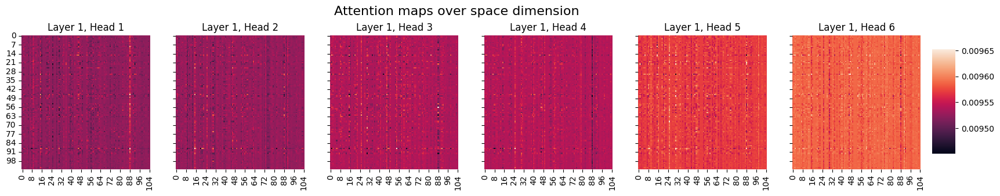

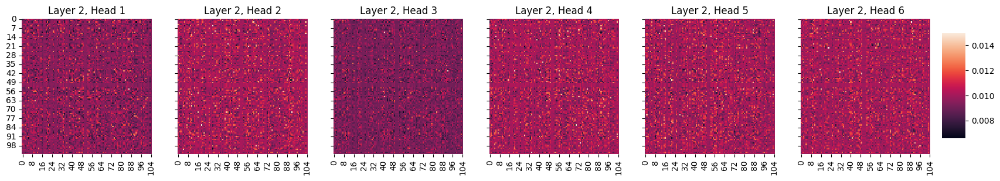

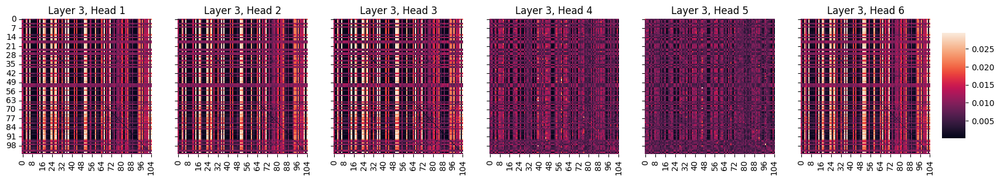

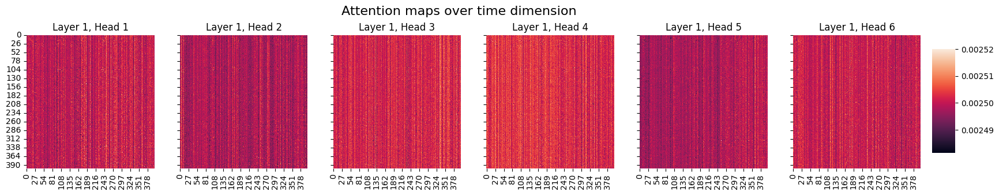

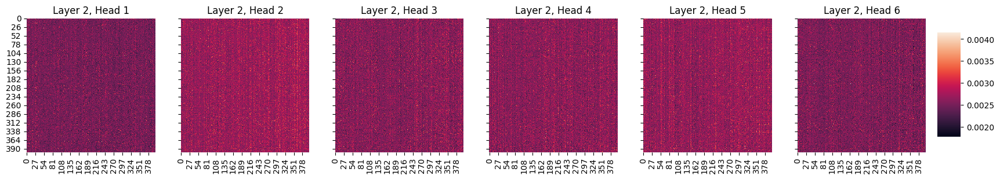

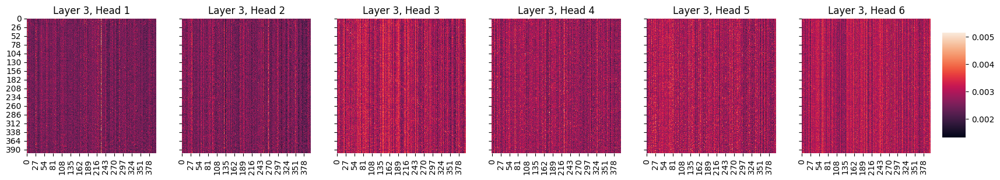

In [92]:
visualize_attention_map(attention_maps_space, attention_maps_time)

6 layers, 3 head

In [93]:
model = Transformer(num_heads = 3, num_layers = 6,dropout = 0.3, learning_rate = 0.00002)
trainer = pylight.Trainer(max_epochs=35, accelerator='gpu', devices=1,default_root_dir="/content/drive/MyDrive/")

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


In [94]:
trainer.fit(model, loader_train, loader_val)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name              | Type               | Params
---------------------------------------------------------
0 | transformer_space | TransformerEncoder | 936 K 
1 | transformer_time  | TransformerEncoder | 13.5 M
2 | classifier        | Linear             | 212   
3 | acc               | MulticlassAccuracy | 0     
4 | dropout           | Dropout            | 0     
---------------------------------------------------------
14.4 M    Trainable params
0         Non-trainable params
14.4 M    Total params
57.659    Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=35` reached.


In [95]:
trainer.test(model, dataloaders=loader_test)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: 0it [00:00, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_acc          │    0.9052144885063171     │
└───────────────────────────┴───────────────────────────┘

[{'test_acc': 0.9052144885063171}]

In [96]:
inp_data, labels = next(iter(loader_test))
attention_maps_space, attention_maps_time= model.get_attention_map(inp_data)

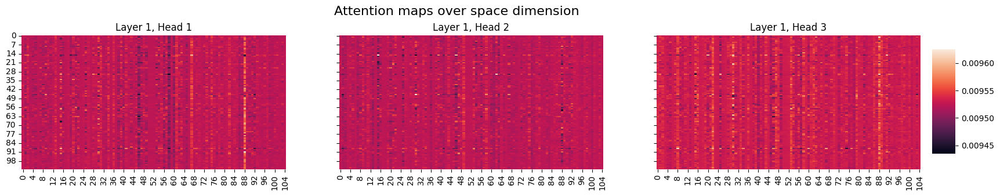

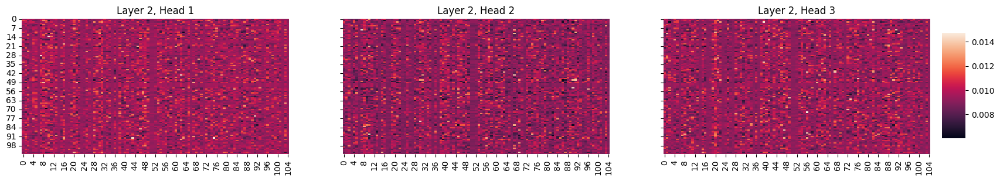

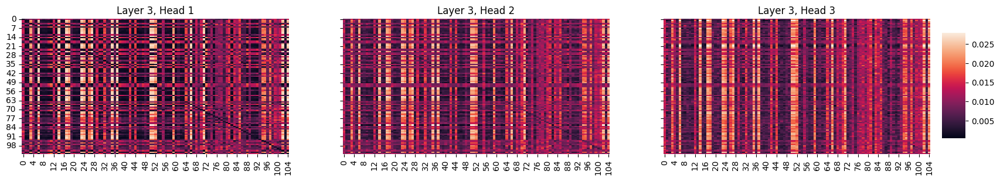

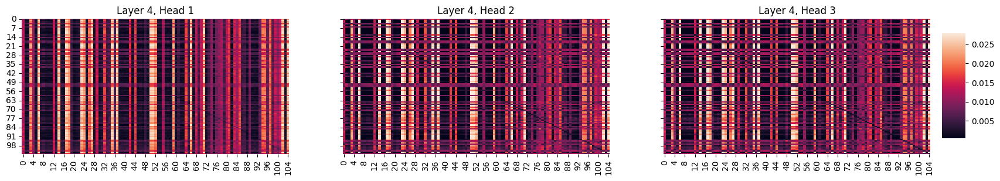

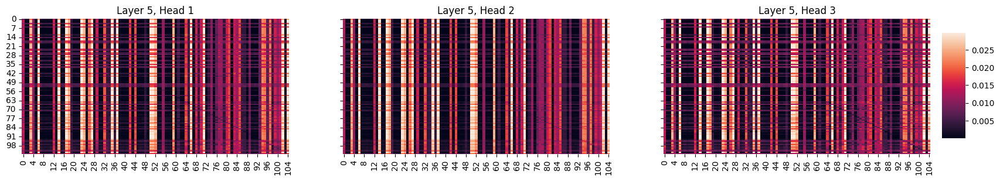

...

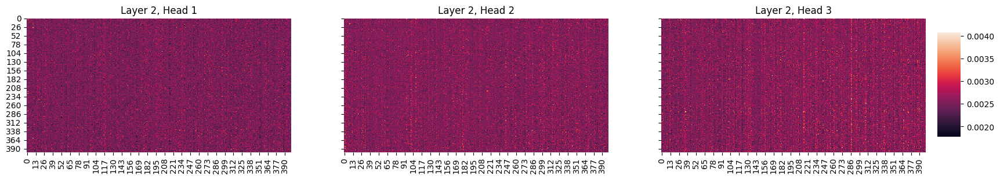

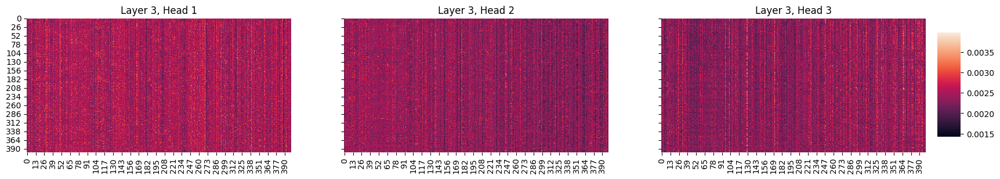

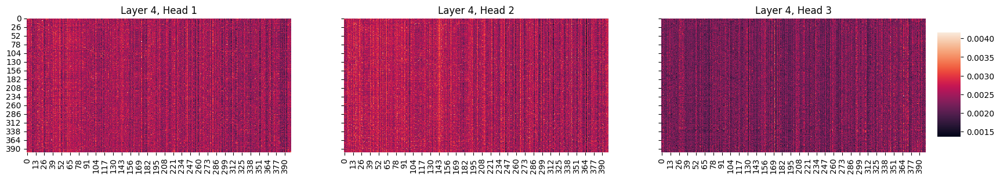

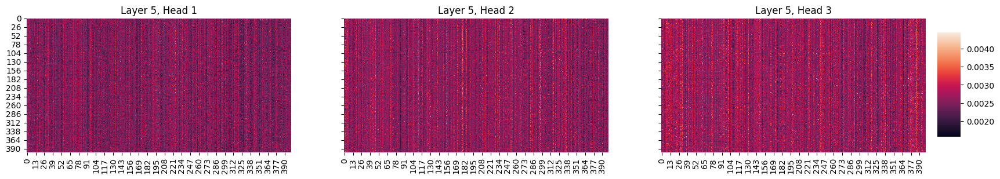

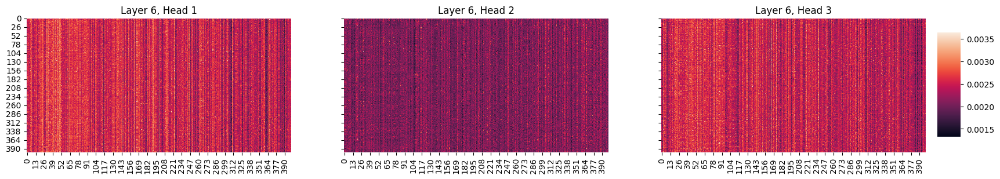

In [97]:
visualize_attention_map(attention_maps_space, attention_maps_time)